# Video Super Resolution

## By Daniel Shkreli and Victor Reyes

### Import what we need

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
import time
import lpips
import torchvision
from torchvision.datasets.video_utils import VideoClips
from torchvision import datasets, models, transforms
from tqdm.notebook import tqdm
import os
import copy
import matplotlib.pyplot as plt
from PIL import Image
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
if torch.cuda.is_available():
    print("Using the GPU!")
else:
    print("WARNING: Could not find GPU! Using CPU only")
    
print(torch.__version__)
print(torchvision.__version__)

Using the GPU!
1.4.0
0.5.0


### Import the dataset
To do this, we will be downloading the videos of the National Geographic channel.

### Create the model
We will use resnet 18, pretrained at first.
from https://github.com/hsinyilin19/ResNetVAE


In [2]:
input_size = 256
data_transforms = {
    'train_in': transforms.Compose([
        transforms.Resize(input_size),
        transforms.CenterCrop(input_size),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'train_in_no_normalize': transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize(input_size),
        transforms.CenterCrop(input_size),

        transforms.ToTensor(),
        #transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'train_target': transforms.Compose([
        transforms.Resize(input_size*2),
        transforms.CenterCrop(input_size*2),
        transforms.ToTensor(),
    ]),
    'val': transforms.Compose([
        transforms.Resize(input_size),
        transforms.CenterCrop(input_size),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'test': transforms.Compose([
        transforms.Resize(input_size),
        transforms.CenterCrop(input_size),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
}
def initialize_resnet_model(train, resume_from = None):
    resnet = models.resnet18(pretrained=True)
    out_size = resnet.fc.in_features
    print("out_size:", out_size)
    layers = []
    for child in resnet.children():
        for param in child.parameters():
            param.requires_grad = train
        layers.append(child)
    resnet = nn.Sequential(*layers[:-1])
    
    #resnet.fc =  # create latent
    
    #resnet.add_module("bottleneck", nn.Sequential()
    if resume_from is not None:
        print(f"Loading weights from {resume_from}")
        model.load_state_dict(torch.load(resume_from))
    return resnet, out_size

def initialize_bottleneck(input_size, latent_size=1024):
    bottleneck = nn.Sequential(nn.Linear(input_size, latent_size),
                               nn.BatchNorm1d(latent_size, momentum=0.01),
                               nn.ReLU(inplace=True))
    return bottleneck

def initialize_decoder():
    stride = (2,2)
    padding = (1,1)
    convTrans6 = nn.Sequential(
        nn.ConvTranspose2d(in_channels=1024, out_channels=1024, kernel_size=(4,4), stride=(1,1),
                           padding=(0,0)),
        nn.BatchNorm2d(1024, momentum=0.01),
        nn.ReLU(inplace=True),
    )
    
    convTrans7 = nn.Sequential(
        nn.ConvTranspose2d(in_channels=1024, out_channels=512, kernel_size=(4,4), stride=stride,
                           padding=padding),
        nn.BatchNorm2d(512, momentum=0.01),
        nn.ReLU(inplace=True),
    )
    
    convTrans8 = nn.Sequential(
        nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=(4,4), stride=stride,
                           padding=padding),
        nn.BatchNorm2d(256, momentum=0.01),
        nn.ReLU(inplace=True),
    )
    
    convTrans9 = nn.Sequential(
        nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=(4,4), stride=stride,
                           padding=padding),
        nn.BatchNorm2d(128, momentum=0.01),
        nn.ReLU(inplace=True),
    )
    
    convTrans10 = nn.Sequential(
        nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=(4,4), stride=stride,
                           padding=padding),
        nn.BatchNorm2d(64, momentum=0.01),
        nn.ReLU(inplace=True),
    )
   
    convTrans11 = nn.Sequential(
        nn.ConvTranspose2d(in_channels=64, out_channels=64, kernel_size=(4,4), stride=stride,
                           padding=padding),
        nn.BatchNorm2d(64, momentum=0.01),
        nn.ReLU(inplace=True),
    )
    
    convTrans12 = nn.Sequential(
        nn.ConvTranspose2d(in_channels=64, out_channels=32, kernel_size=(4,4), stride=stride,
                           padding=padding),
        nn.BatchNorm2d(32, momentum=0.01),
        nn.ReLU(inplace=True),
    )
    
    convTrans13 = nn.Sequential(
        nn.ConvTranspose2d(in_channels=32, out_channels=3, kernel_size=(4,4), stride=stride,
                           padding=padding),
        nn.BatchNorm2d(3, momentum=0.01),
        nn.Sigmoid(),
    )
    return nn.Sequential(convTrans6,
                         convTrans7,
                         convTrans8,
                         convTrans9,
                         convTrans10,
                         convTrans11,
                         convTrans12,
                         convTrans13) 

    




def get_dataloaders(batch_size, input_size = 256, shuffle = True):
    
    train_dataset = datasets.ImageFolder(root="yt-dls/train/", transform = data_transforms['train_target'])
    val_dataset = datasets.ImageFolder(root="yt-dls/val/",  transform = data_transforms['train_target'])
    test_dataset = datasets.ImageFolder(root="yt-dls/test/",  transform = data_transforms['train_target'])

    dataloaders_dict = {'train': torch.utils.data.DataLoader(train_dataset, batch_size = batch_size, shuffle = True),
                       'val': torch.utils.data.DataLoader(val_dataset, batch_size = batch_size, shuffle = True),
                       'test': torch.utils.data.DataLoader(test_dataset, batch_size = batch_size, shuffle = True)}
    return dataloaders_dict

In [3]:
#dl = get_dataloaders(5)
#print(dl['train'])
#video_folders = os.listdir("yt-dls/train/0")
#np.random.permutation(video_folders)

In [4]:
def make_optimizer(resnet, bottleneck, decoder, train_resnet, train_bottleneck):
    # Get all the parameters
    #print("bottleneck params", bottleneck.parameters())
    #print("decoder params", decoder.parameters())
    params_to_update = list(decoder.parameters())
    
    if train_resnet:       
        params_to_update += list(resnet.parameters()) 
    if train_bottleneck:
        params_to_update += list(bottleneck.parameters())
        
    #print("Params to learn:")
#     for name, param in resnet.named_parameters():
#         if param.requires_grad == True:
#             print("\t",name)
#     for name, param in bottleneck.named_parameters():
#         if param.requires_grad == True:
#             print("\t",name)
#     for name, param in decoder.named_parameters():
#         if param.requires_grad == True:
#             print("\t",name)
    # Use SGD
    optimizer = optim.Adam(params_to_update, lr=0.001)
    #optimizer = optim.Adagrad(params_to_update, lr=0.001)
    #optimizer = optim.Adadelta(params_to_update, lr=0.001)
    #optimizer = optim.SGD(params_to_update, lr=0.001, momentum=0.9)
    return optimizer

In [5]:
def fit_one_point(resnet, bottleneck, decoder, point, in_transforms, target_transforms, iterations=1000):
    batched_input_1 = []
    batched_input_2 = []
    batched_targets = []
    for example in point:  
        in_1 = in_transforms(example[0].permute(2,0,1)) # frame_i-1
        in_2 = in_transforms(example[1].permute(2,0,1)) # frame_i
        target = target_transforms(example[1].permute(2,0,1))
        batched_input_1.append(in_1)
        batched_input_2.append(in_2)
        batched_targets.append(target)
    batched_input_1 = torch.stack(batched_input_1).to(device)
    batched_input_2 = torch.stack(batched_input_2).to(device)
    batched_targets = torch.stack(batched_targets).to(device)

    optimizer = make_optimizer(bottleneck, decoder)
    resnet.eval()
    bottleneck.train()
    decoder.train()
    losses = []
    for i in range(1000):
        optimizer.zero_grad()
        with torch.set_grad_enabled(True):
            embedding_1 = resnet(batched_input_1)
            embedding_2 = resnet(batched_input_2)

            cat_latent = torch.cat((embedding_1, embedding_2), dim=1)
            moved_latent = torch.squeeze(cat_latent)
            
            latent = bottleneck(moved_latent)
            
            prediction = decoder(latent.unsqueeze(-1).unsqueeze(-1))
            mse_loss = nn.MSELoss()
            mse_loss_val = mse_loss(prediction, batched_targets)
            loss = 1 * mse_loss_val
            print(loss)
            losses.append(loss.item())
            loss.backward()
            optimizer.step()
    return [prediction, losses]

def train(resnet, bottleneck, decoder, optimizer, data_transforms, train_resnet, num_epochs=25):
    since = time.time()
    mse_loss_history = []
    best_model_wts = {'resnet':copy.deepcopy(resnet.state_dict()),
                      'bottleneck':copy.deepcopy(bottleneck.state_dict()),
                      'decoder':copy.deepcopy(decoder.state_dict())
                     }
    best_loss = 1000
    val_loss_history = []
    # criterion
    #percept = lpips.LPIPS(net='vgg')
    #percept.to(device)
    mse_loss = nn.MSELoss()
    for epoch in range(num_epochs):
        print(f"Epoch {epoch}/{num_epochs-1}")
        print('-'*10)
        
        # train and validate
        for phase in ['train', 'val']:
            if phase == 'train':
                if train_resnet:
                    resnet.train()
                bottleneck.train()
                decoder.train()
                root = "yt-dls/train/0/"
                video_folders = np.random.permutation(os.listdir(root))
                num_batches = len(video_folders)//5
                #print(f"num_batches:{num_batches}")
                batches = [[video_folders[5*i + j] for j in range(0,5)] for i in range(num_batches)]                
            else:
                resnet.eval()
                bottleneck.eval()
                decoder.eval()
                root = "yt-dls/val/0/"
                video_folders = np.random.permutation(os.listdir(root))
                num_batches = len(video_folders)//5
                #print(f"num_batches:{num_batches}")
                batches = [[video_folders[5*i + j] for j in range(0,5)] for i in range(num_batches)]
     
            running_loss = 0.0
            
            
            for batch in tqdm(batches):
                optimizer.zero_grad()
                
                batched_input_1 = []
                batched_input_2 = []
                batched_targets = []
                for video_folder in batch:
                    # build up the batch
                    #print(video_folder)
                    num_frames = 60 # fit in memory 5 * numframes
                    frame_filenames = sorted(list(os.listdir(os.path.join(root, video_folder))))[0:num_frames]
                    for i, frame_filename in enumerate(frame_filenames):
                        #print(f"i, {i}")
                        #print(f"frame_filename, {frame_filename}")
                        frame_img = Image.open(os.path.join(root, video_folder, frame_filename))
                        if i % 2 == 0:
                            in_1 = data_transforms['train_in'](frame_img) # frame_i-1
                            batched_input_1.append(in_1)
                        else:
                            in_2 = data_transforms['train_in'](frame_img)
                            batched_input_2.append(in_2)
                            target = data_transforms['train_target'](frame_img)
                            #plt.imshow(transforms.functional.to_pil_image(target))
                            #plt.show()
                            batched_targets.append(target)
                            
                batched_input_1 = torch.stack(batched_input_1).to(device)
                batched_input_2 = torch.stack(batched_input_2).to(device)
                batched_targets = torch.stack(batched_targets).to(device)
                
                
                with torch.set_grad_enabled(phase == 'train'):
                    embedding_1 = resnet(batched_input_1)
                    embedding_2 = resnet(batched_input_2)
                    
                    cat_latent = torch.cat((embedding_1, embedding_2), dim=1)
                    #moved_latent = torch.squeeze(cat_latent)

                    #latent = bottleneck(moved_latent)
                    #print(latent.shape)
                    #print((latent.unsqueeze(-1).unsqueeze(-1)).shape)
                    #print(f"cat_latent.shape: {cat_latent.shape}")
                    prediction = decoder(cat_latent)
                    
                    #perceptual_loss = percept.forward(prediction, batched_targets)
                    mse_loss_val = mse_loss(prediction, batched_targets)
                    loss = mse_loss_val
                    #loss = perceptual_loss.sum()
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()
            print(f"{phase} Loss: {loss:.4f}")
            if phase == 'val' and loss < best_loss:
                best_loss = loss
                best_model_wts = {'resnet':copy.deepcopy(resnet.state_dict()),
                                  'bottleneck':copy.deepcopy(bottleneck.state_dict()),
                                  'decoder':copy.deepcopy(decoder.state_dict())
                                 }
            if phase == 'val':
                val_loss_history.append(loss.item())
                
    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(time_elapsed // 60, time_elapsed % 60))
    print('Best val loss: {:4f}'.format(best_loss))
    
    # save and load best model weights
    torch.save(best_model_wts, os.path.join("saved", 'weights_best.pt'))
    
    resnet.load_state_dict(best_model_wts['resnet'])
    bottleneck.load_state_dict(best_model_wts['bottleneck'])
    decoder.load_state_dict(best_model_wts['decoder'])
    
    return resnet, bottleneck, decoder, val_loss_history

In [6]:
# # get a point
# sample_video_filename = "yt-dls/train/0/Secrets of the Whales _ Official Trailer _ Disney+.mp4"
# sample_video_filename2 = 'yt-dls/train/0/The Race For the COVID-19 Vaccine _ National Geographic.mp4'

# sample_video = VideoClips([sample_video_filename], clip_length_in_frames=2, frames_between_clips=10, frame_rate=10)
# sample_video2 = VideoClips([sample_video_filename2], clip_length_in_frames=2, frames_between_clips=10, frame_rate=10)

# clip = sample_video.get_clip(0)
# clip2 = sample_video2.get_clip(0)

# batched_point = [clip[0], clip2[0]]

In [7]:
# # fit a point
# resnet, out_size = initialize_resnet_model()
# resnet.to(device)
# bottleneck = initialize_bottleneck(2*out_size).to(device)
# decoder = initialize_decoder().to(device)
# print(resnet)
# print(bottleneck)
# print(decoder)
# last_prediction, losses = fit_one_point(resnet, bottleneck, decoder, batched_point, data_transforms['train_in'], data_transforms['train_target'])


In [8]:
# test training
train_resnet = False
resnet, out_size = initialize_resnet_model(train_resnet)
resnet.to(device)
print(f"Each resnet is outputting {out_size} embedding.")
bottleneck = initialize_bottleneck(2*out_size, latent_size = 2*out_size).to(device)
decoder = initialize_decoder().to(device)
optimizer = make_optimizer(resnet, bottleneck, decoder, train_resnet = train_resnet, train_bottleneck=False)
#print(resnet)
#print(bottleneck)
#print(decoder)
resnet_result, bottleneck_result, decoder_result, val_loss_history = train(resnet, bottleneck, decoder, optimizer, data_transforms, train_resnet, 100)


out_size: 512
Each resnet is outputting 512 embedding.
Epoch 0/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0828


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.3352
Epoch 1/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0920


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.3544
Epoch 2/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0964


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.3649
Epoch 3/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0676


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.3711
Epoch 4/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0700


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.3777
Epoch 5/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0843


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.3760
Epoch 6/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0600


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.3607
Epoch 7/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.1125


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.3368
Epoch 8/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0847


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.3060
Epoch 9/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0768


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.2814
Epoch 10/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0856


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.1668
Epoch 11/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0693


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.1497
Epoch 12/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0579


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.1187
Epoch 13/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0631


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.1365
Epoch 14/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0395


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0739
Epoch 15/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0521


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0787
Epoch 16/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0564


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0783
Epoch 17/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0398


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0713
Epoch 18/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0614


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0723
Epoch 19/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0446


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0781
Epoch 20/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0505


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0792
Epoch 21/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0455


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0738
Epoch 22/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0519


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0703
Epoch 23/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0572


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0736
Epoch 24/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0552


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0695
Epoch 25/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0408


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0669
Epoch 26/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0470


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0709
Epoch 27/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0335


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0694
Epoch 28/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0541


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0733
Epoch 29/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0549


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0747
Epoch 30/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0365


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0718
Epoch 31/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0382


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0757
Epoch 32/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0402


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0723
Epoch 33/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0366


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0759
Epoch 34/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0375


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0759
Epoch 35/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0305


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0728
Epoch 36/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0480


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0770
Epoch 37/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0382


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0740
Epoch 38/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0317


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0793
Epoch 39/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0303


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0791
Epoch 40/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0329


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0768
Epoch 41/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0490


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0764
Epoch 42/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0314


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0771
Epoch 43/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0399


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0801
Epoch 44/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0252


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0749
Epoch 45/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0367


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0776
Epoch 46/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0431


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0763
Epoch 47/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0246


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0751
Epoch 48/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0244


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0765
Epoch 49/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0348


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0747
Epoch 50/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0256


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0776
Epoch 51/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0302


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0764
Epoch 52/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0268


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0778
Epoch 53/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0234


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0747
Epoch 54/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0255


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0752
Epoch 55/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0215


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0751
Epoch 56/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0253


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0753
Epoch 57/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0216


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0750
Epoch 58/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0331


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0726
Epoch 59/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0252


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0749
Epoch 60/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0215


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0790
Epoch 61/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0385


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0748
Epoch 62/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0335


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0732
Epoch 63/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0271


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0736
Epoch 64/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0182


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0757
Epoch 65/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0366


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0767
Epoch 66/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0175


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0776
Epoch 67/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0208


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0795
Epoch 68/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0188


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0780
Epoch 69/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0310


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0799
Epoch 70/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0196


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0796
Epoch 71/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0247


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0787
Epoch 72/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0241


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0772
Epoch 73/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0240


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0804
Epoch 74/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0217


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0775
Epoch 75/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0208


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0792
Epoch 76/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0199


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0763
Epoch 77/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0260


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0803
Epoch 78/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0240


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0785
Epoch 79/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0169


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0810
Epoch 80/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0156


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0782
Epoch 81/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0366


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0808
Epoch 82/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0254


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0800
Epoch 83/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0249


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0812
Epoch 84/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0204


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0799
Epoch 85/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0183


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0841
Epoch 86/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0193


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0780
Epoch 87/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0204


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0870
Epoch 88/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0242


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0799
Epoch 89/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0159


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0872
Epoch 90/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0535


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0949
Epoch 91/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0183


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0998
Epoch 92/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0236


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0890
Epoch 93/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0236


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0909
Epoch 94/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0180


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0906
Epoch 95/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0168


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0853
Epoch 96/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0188


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0861
Epoch 97/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0182


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0820
Epoch 98/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0153


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0845
Epoch 99/99
----------


  0%|          | 0/8 [00:00<?, ?it/s]

train Loss: 0.0320


  0%|          | 0/1 [00:00<?, ?it/s]

val Loss: 0.0817
Training complete in 145m 44s
Best val loss: 0.066874


In [16]:
# view testing data
resnet_result.eval()
bottleneck_result.eval()
decoder_result.eval()

def test_visualize(resnet, bottleneck, decoder):
    root = "yt-dls/test/0/"
    video_folders = np.random.permutation(os.listdir(root))
    print(video_folders)
    frames = []
    batched_input_1 = []
    batched_input_2 = []
    batched_targets = []
    for video_folder in video_folders:
        # build up the batch
        #print(video_folder)
        num_frames = 30 # fit in memory batch * numframes
        frame_filenames = sorted(list(os.listdir(os.path.join(root, video_folder))))[0:num_frames]
        for i, frame_filename in enumerate(frame_filenames):
            #print(f"i, {i}")
            #print(f"frame_filename, {frame_filename}")
            frame_img = Image.open(os.path.join(root, video_folder, frame_filename))
            frames.append(frame_img)
            #plt.imshow(frame_img)
            #plt.show()
            if i % 2 == 0:
                in_1 = data_transforms['train_in'](frame_img) # frame_i-1
                batched_input_1.append(in_1)
            else:
                in_2 = data_transforms['train_in'](frame_img)
                batched_input_2.append(in_2)
                target = data_transforms['train_target'](frame_img)
                batched_targets.append(target)
    batched_input_1 = torch.stack(batched_input_1).to(device)
    batched_input_2 = torch.stack(batched_input_2).to(device)
    batched_targets = torch.stack(batched_targets).to(device)

    embedding_1 = resnet(batched_input_1)
    embedding_2 = resnet(batched_input_2)

    cat_latent = torch.cat((embedding_1, embedding_2), dim=1)
    moved_latent = torch.squeeze(cat_latent)

    latent = bottleneck(moved_latent)

    prediction = decoder(latent.unsqueeze(-1).unsqueeze(-1))
    mse_loss = nn.MSELoss()
    mse_loss_val = mse_loss(prediction, batched_targets)
    loss = 1 * mse_loss_val

    print(loss)

    print(prediction.shape)
    print(target.shape)
    for i in range(len(prediction)):
        plt.imshow(frames[i*2])
        print("input_1")
        plt.show()
        plt.imshow(frames[i*2 + 1])
        print("input_2")
        plt.show()
        plt.imshow(transforms.functional.to_pil_image(prediction[i].cpu()))
        print("prediction")
        plt.show()
        plt.imshow(transforms.functional.to_pil_image(batched_targets[i].cpu()))
        print("target")
        plt.show()


In [10]:
print(resnet_result)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Con

In [11]:
print("as")

as


['Inside_Terminal_4-Terminal_of_Tomorrow-Full_Episode_National_Geographic'
 'Unraveling_a_Mapmaker_s_Dangerous_Decision_Podcast_Overheard_at_National_Geographic'
 'Why_War_Zones_Need_Science_Podcast_Overheard_at_National_Geographic'
 'Joe_Exotic_and_the_Tiger_Trade_Trafficked_with_Mariana_van_Zeller'
 'Feast_or_Famine-Full_Episode-Ice_Road_Rescue']
tensor(0.1024, device='cuda:0', grad_fn=<MulBackward0>)
torch.Size([75, 3, 512, 512])
torch.Size([3, 512, 512])
input_1


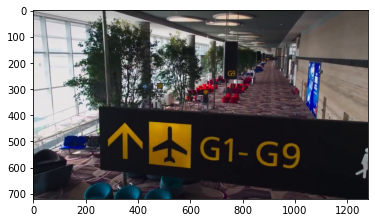

input_2


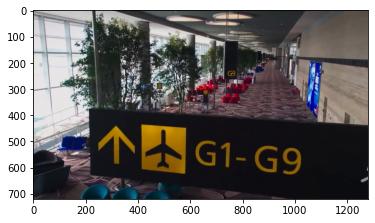

prediction


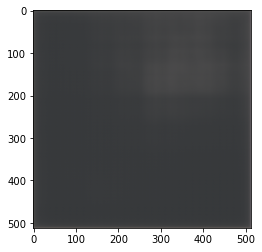

target


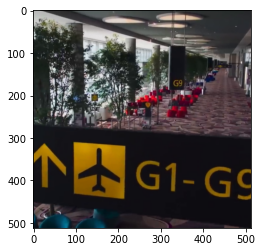

input_1


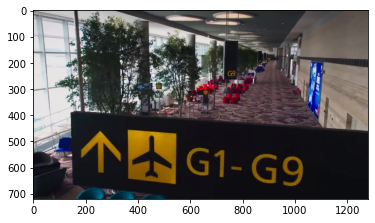

input_2


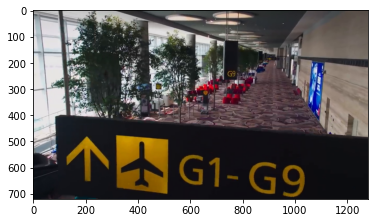

prediction


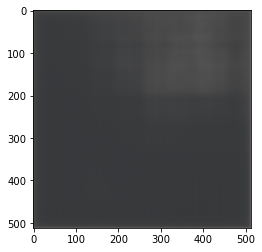

target


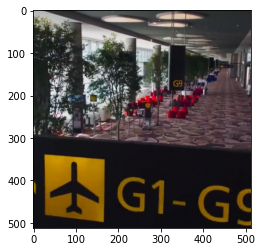

input_1


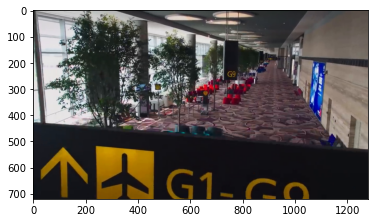

input_2


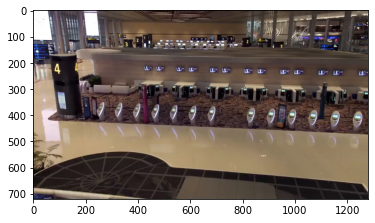

prediction


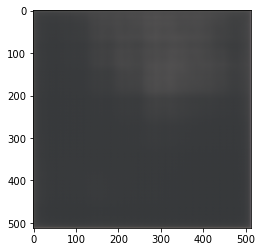

target


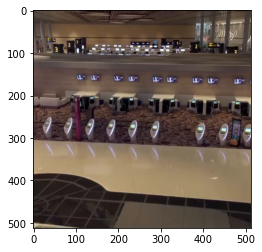

input_1


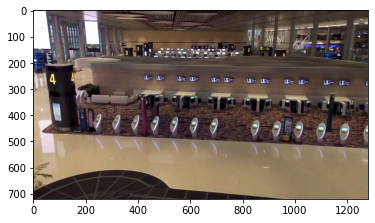

input_2


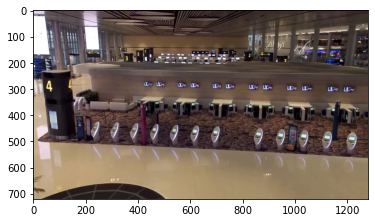

prediction


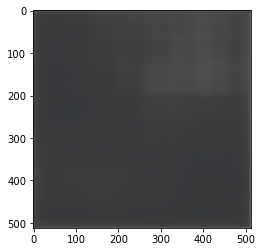

target


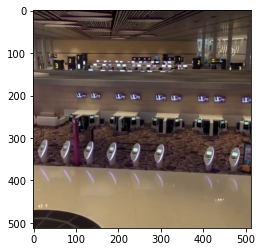

input_1


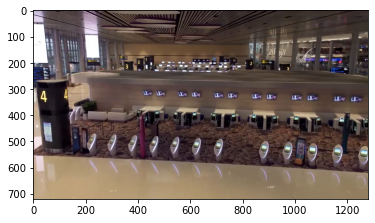

input_2


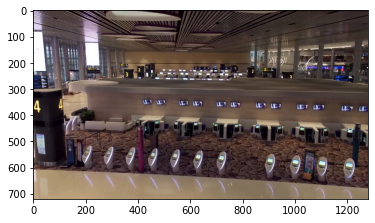

prediction


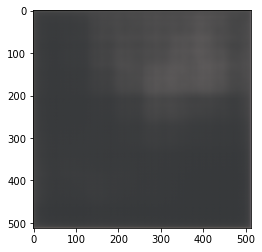

target


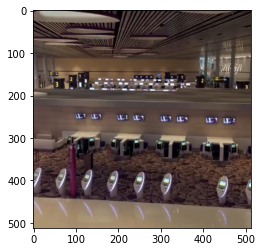

input_1


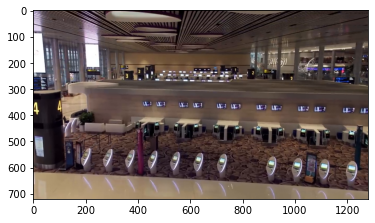

input_2


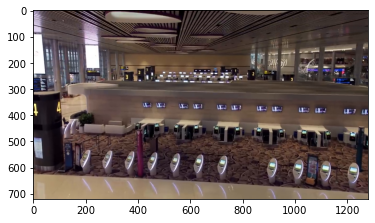

prediction


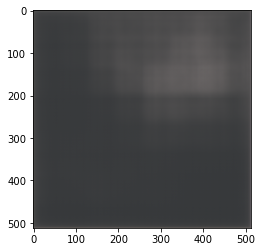

target


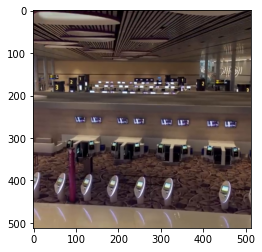

input_1


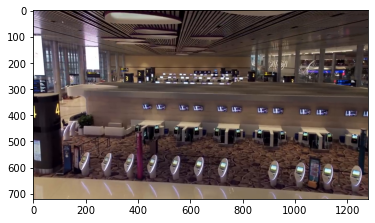

input_2


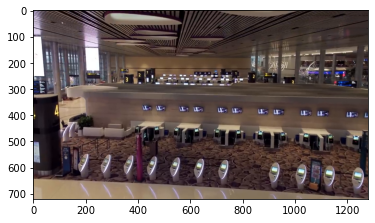

prediction


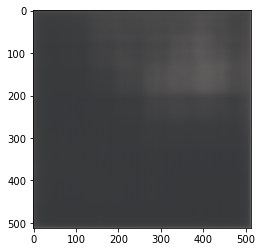

target


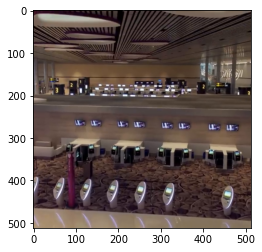

input_1


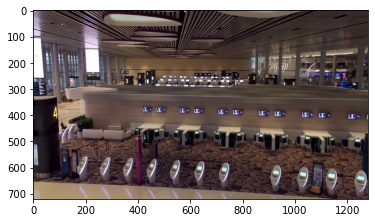

input_2


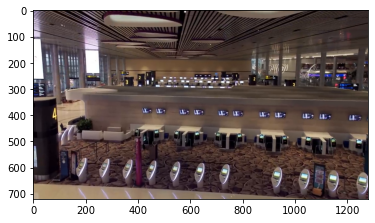

prediction


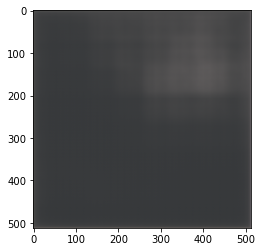

target


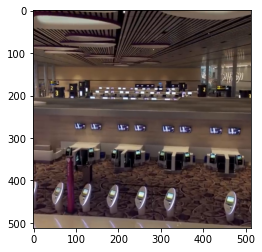

input_1


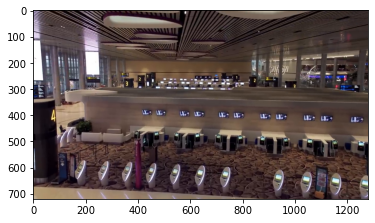

input_2


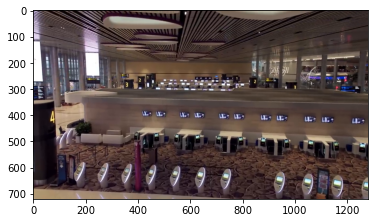

prediction


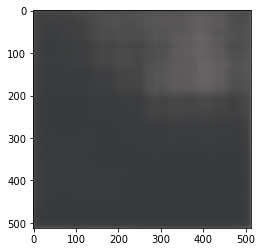

target


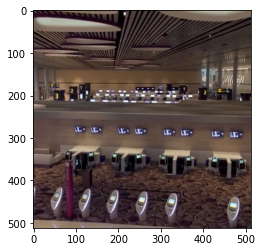

input_1


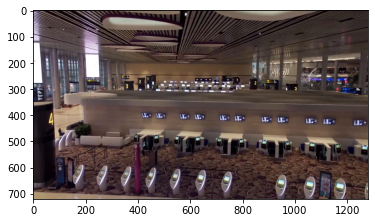

input_2


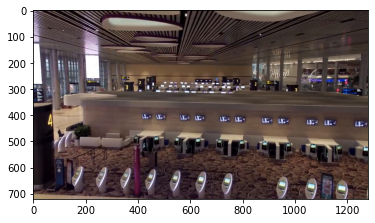

prediction


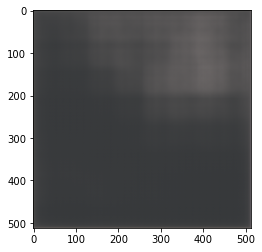

target


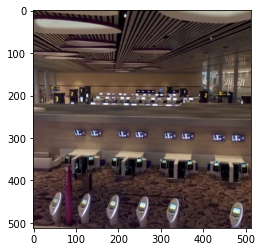

input_1


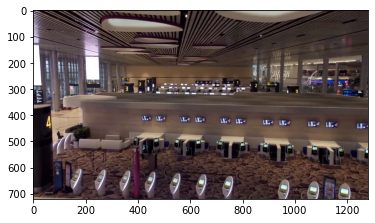

input_2


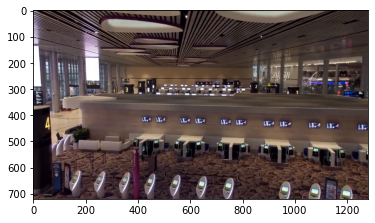

prediction


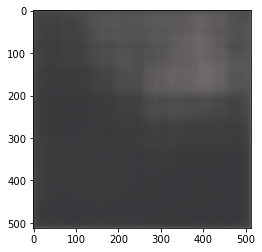

target


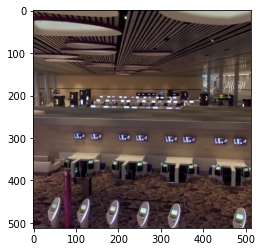

input_1


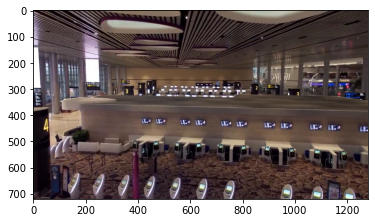

input_2


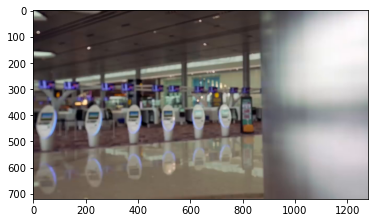

prediction


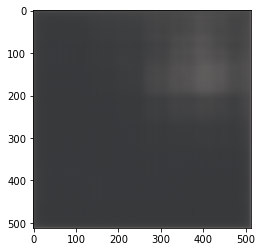

target


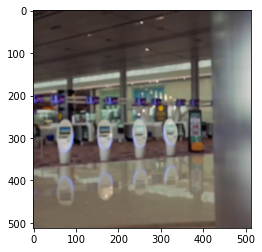

input_1


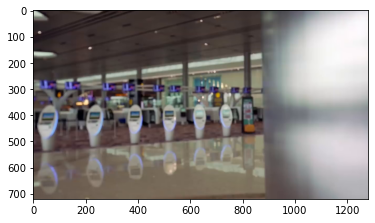

input_2


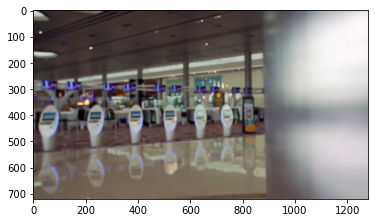

prediction


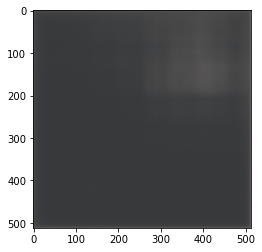

target


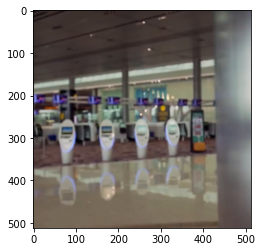

input_1


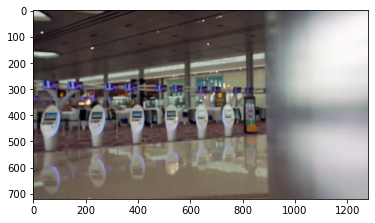

input_2


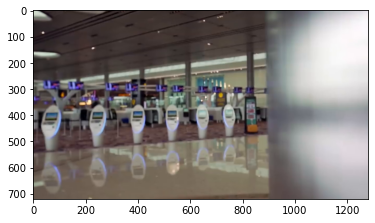

prediction


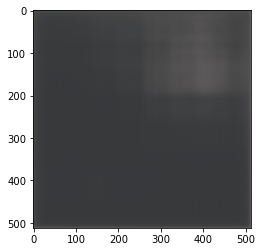

target


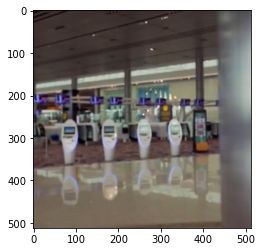

input_1


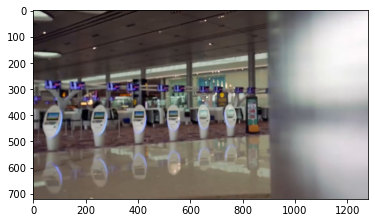

input_2


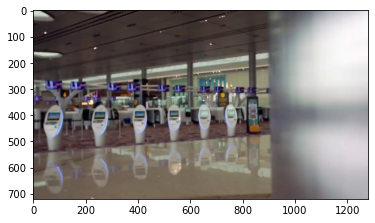

prediction


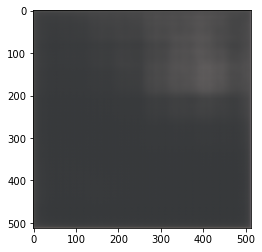

target


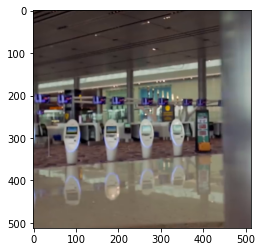

input_1


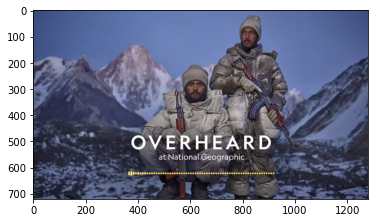

input_2


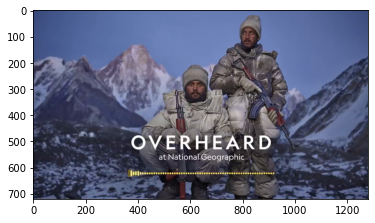

prediction


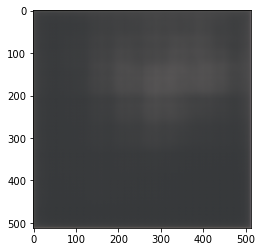

target


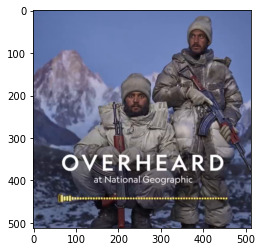

input_1


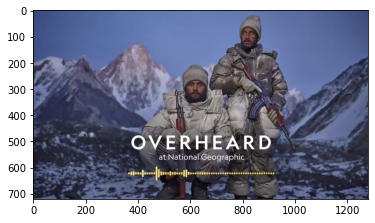

input_2


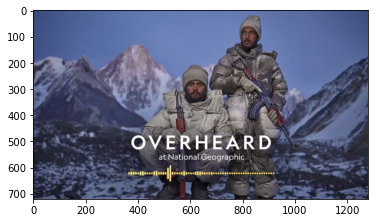

prediction


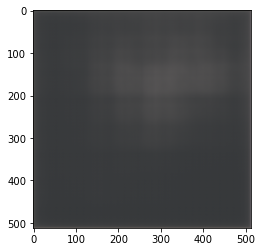

target


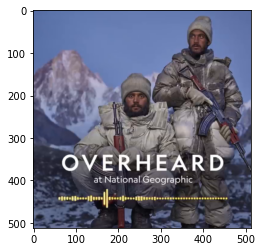

input_1


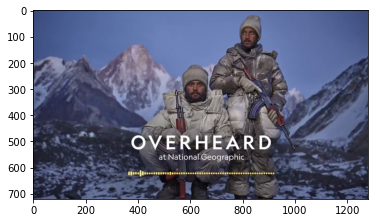

input_2


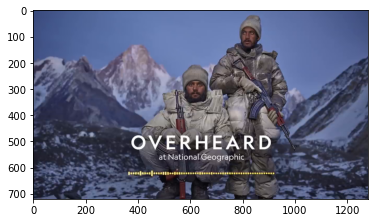

prediction


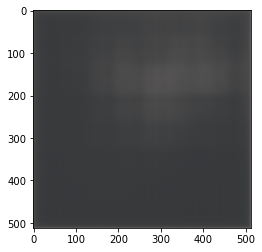

target


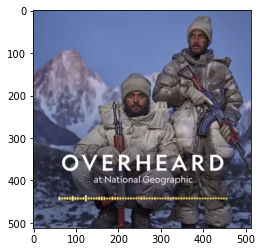

input_1


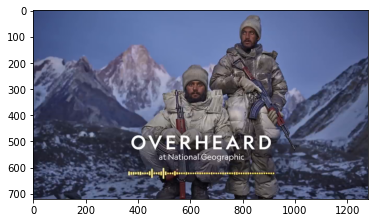

input_2


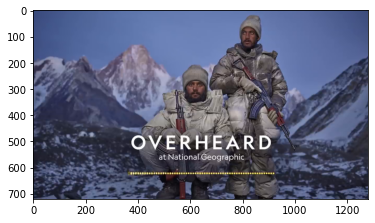

prediction


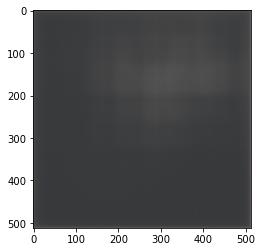

target


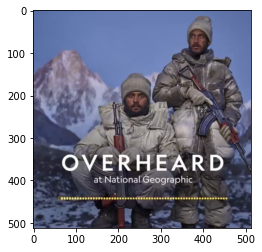

input_1


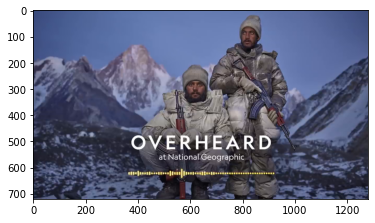

input_2


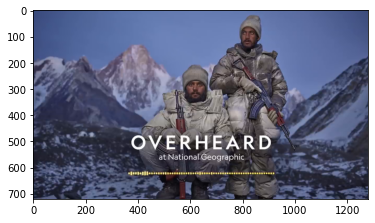

prediction


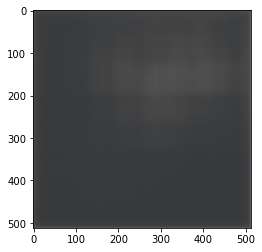

target


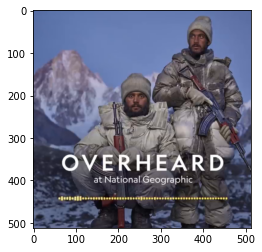

input_1


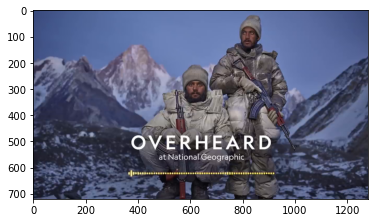

input_2


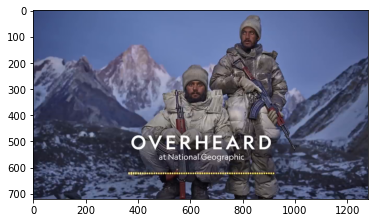

prediction


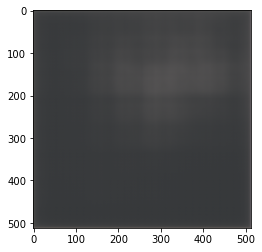

target


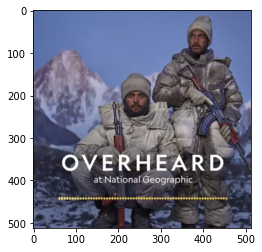

input_1


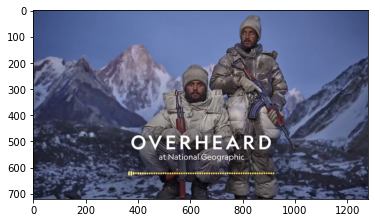

input_2


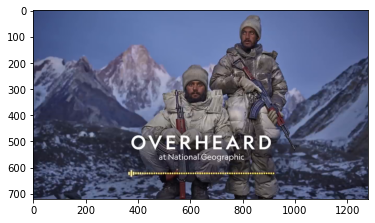

prediction


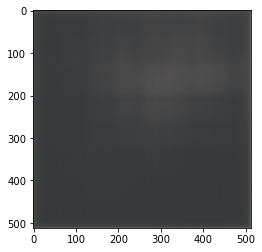

target


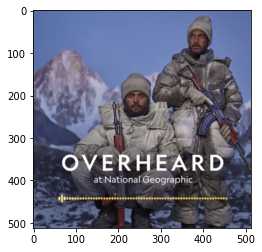

input_1


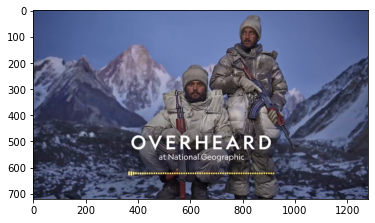

input_2


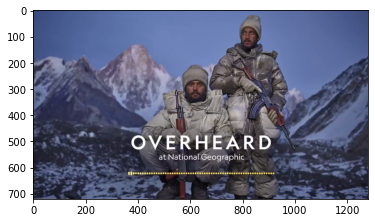

prediction


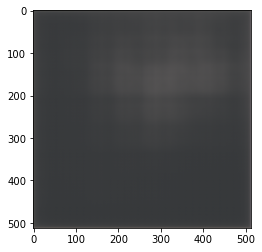

target


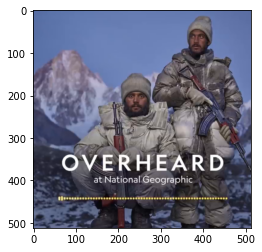

input_1


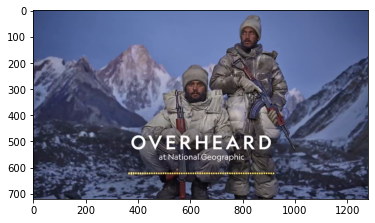

input_2


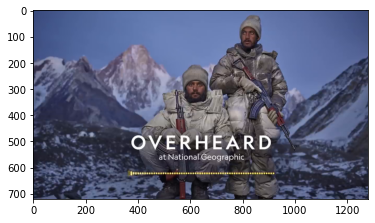

prediction


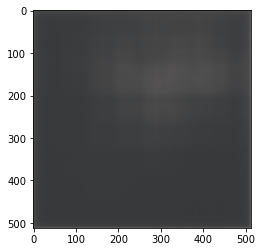

target


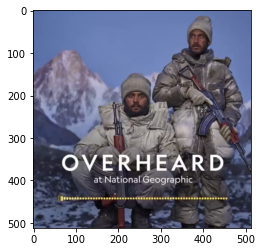

input_1


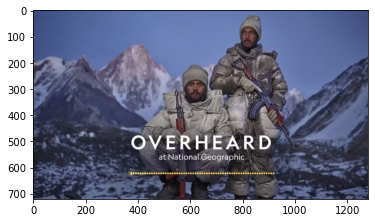

input_2


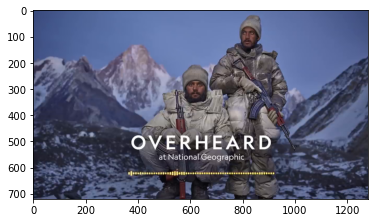

prediction


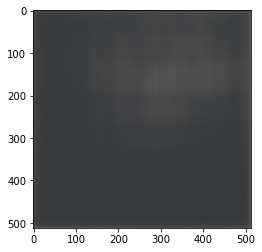

target


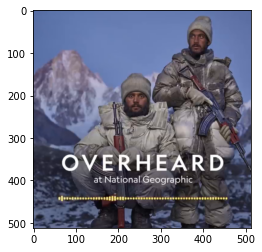

input_1


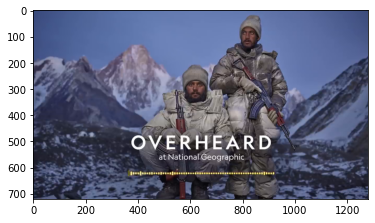

input_2


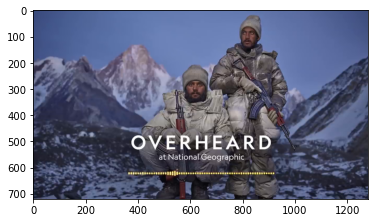

prediction


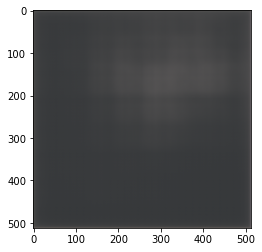

target


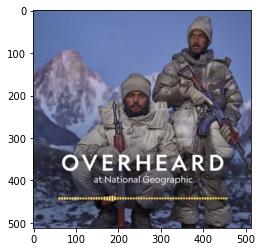

input_1


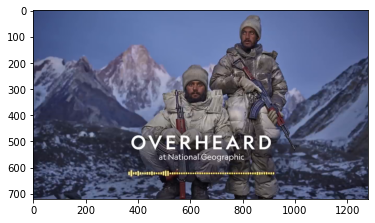

input_2


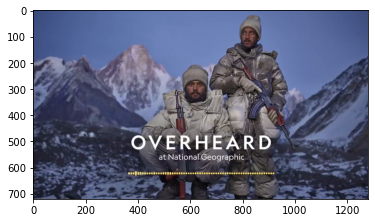

prediction


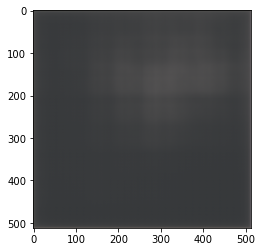

target


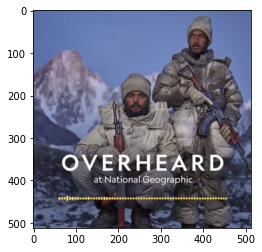

input_1


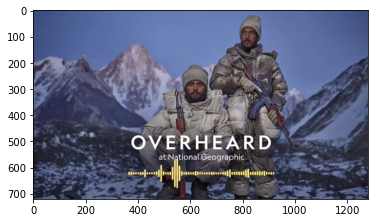

input_2


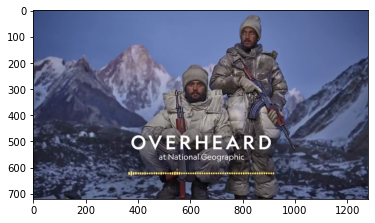

prediction


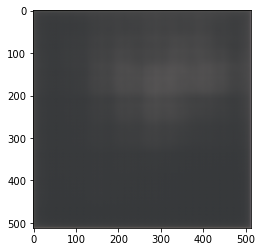

target


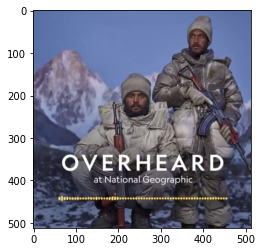

input_1


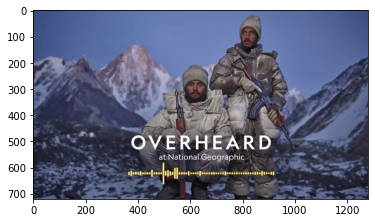

input_2


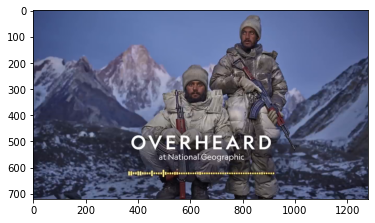

prediction


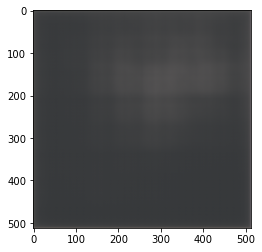

target


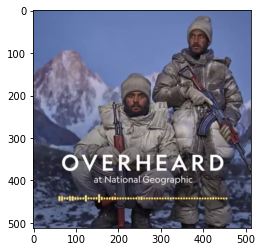

input_1


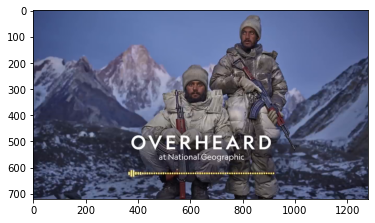

input_2


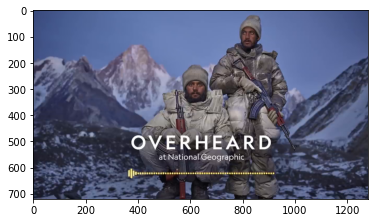

prediction


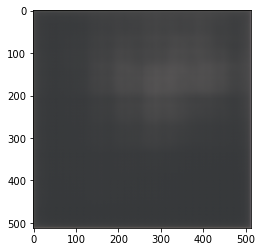

target


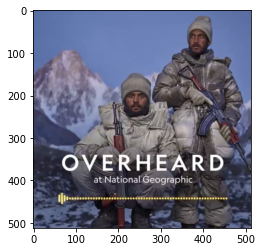

input_1


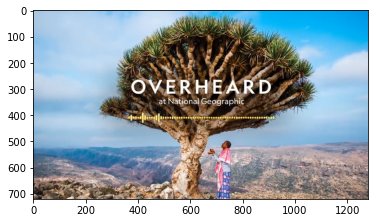

input_2


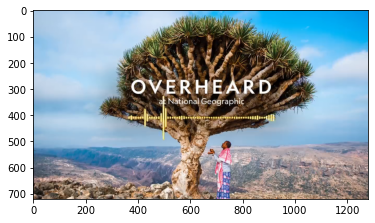

prediction


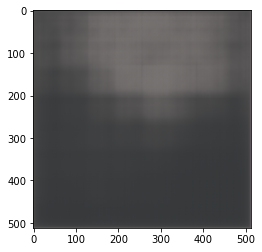

target


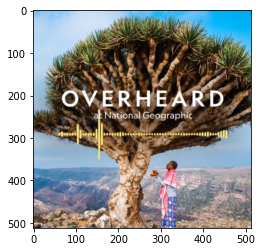

input_1


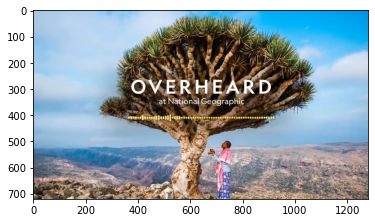

input_2


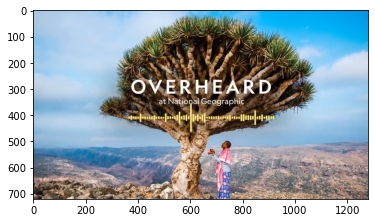

prediction


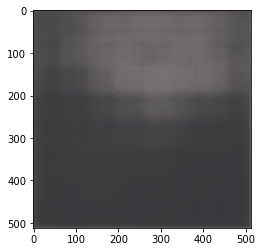

target


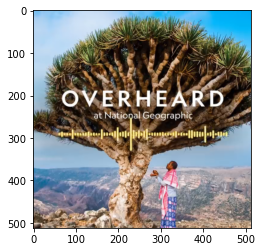

input_1


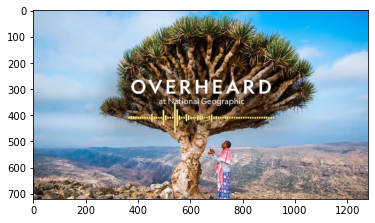

input_2


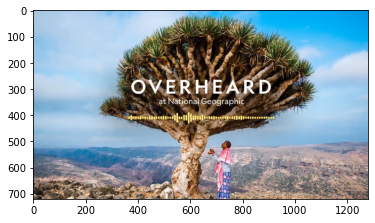

prediction


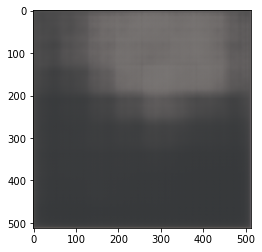

target


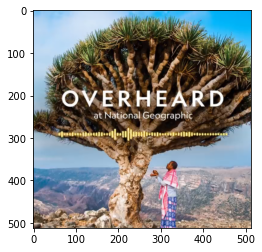

input_1


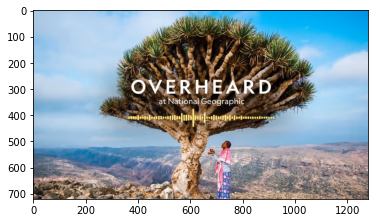

input_2


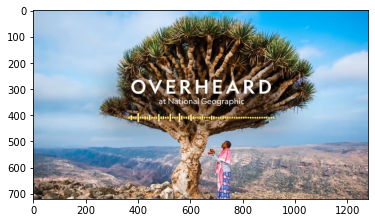

prediction


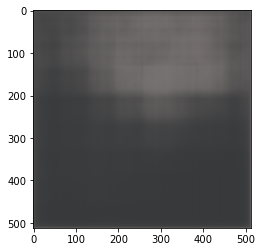

target


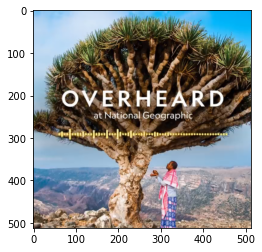

input_1


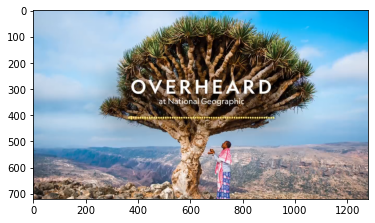

input_2


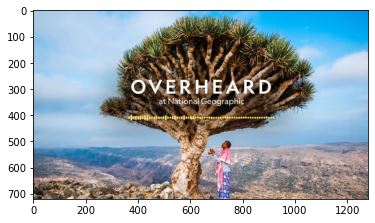

prediction


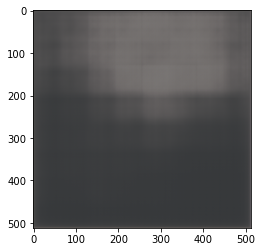

target


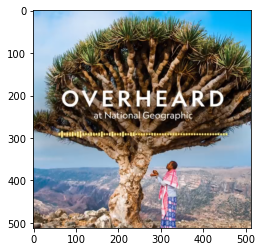

input_1


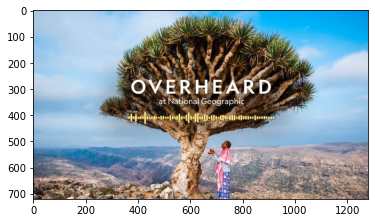

input_2


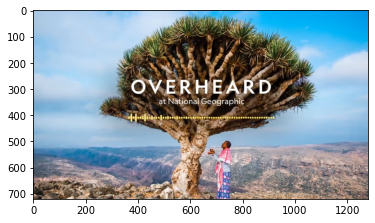

prediction


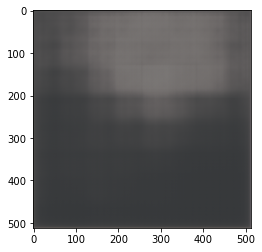

target


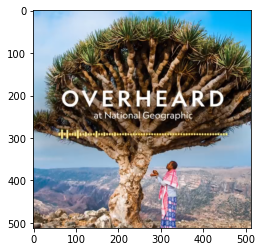

input_1


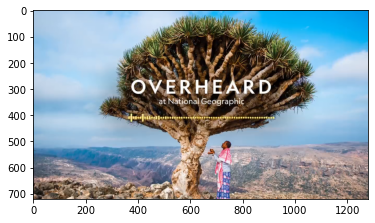

input_2


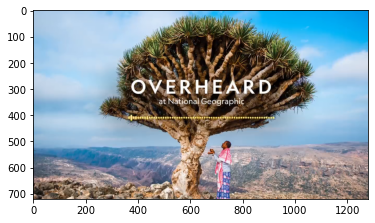

prediction


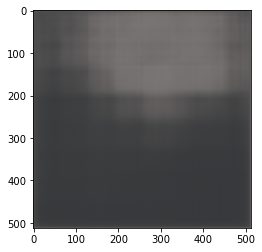

target


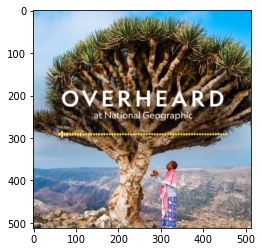

input_1


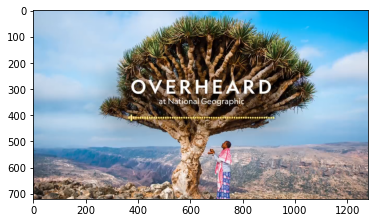

input_2


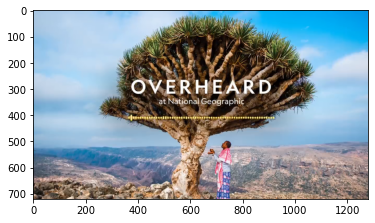

prediction


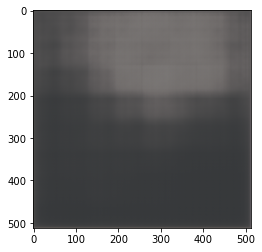

target


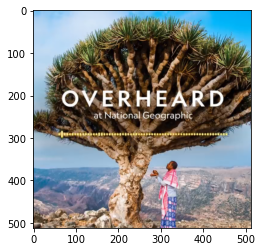

input_1


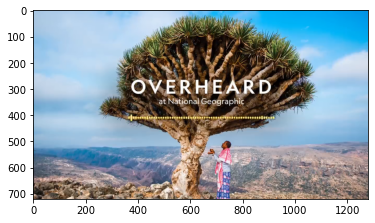

input_2


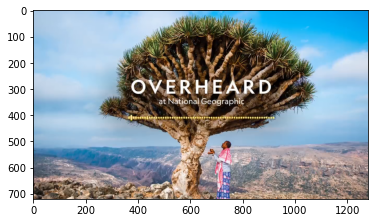

prediction


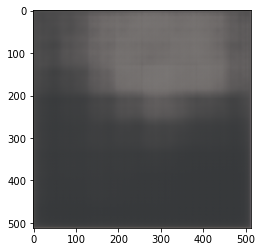

target


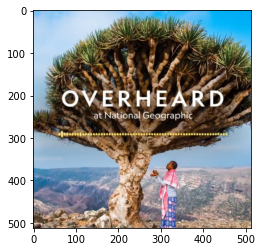

input_1


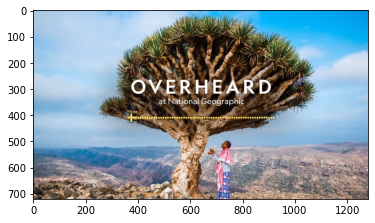

input_2


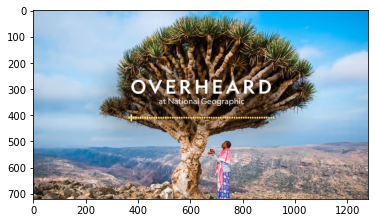

prediction


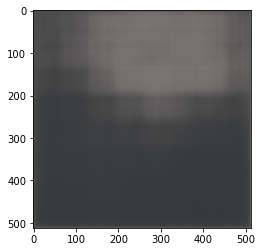

target


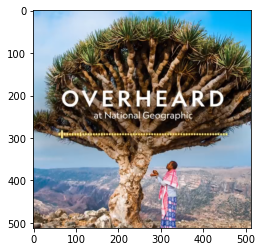

input_1


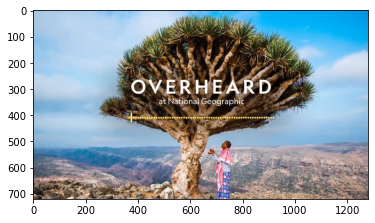

input_2


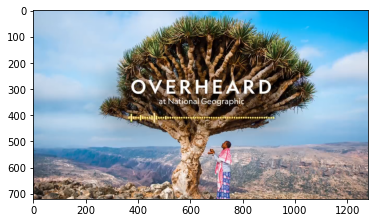

prediction


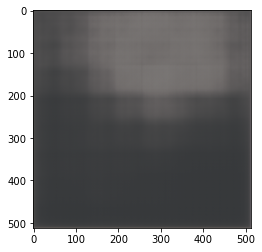

target


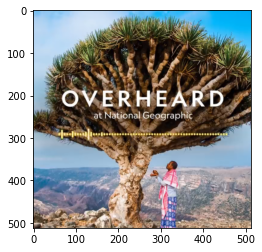

input_1


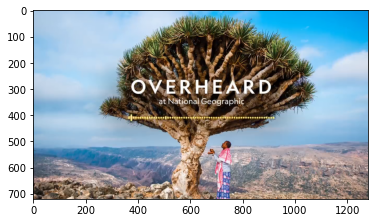

input_2


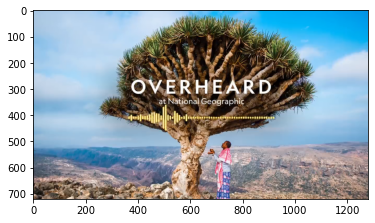

prediction


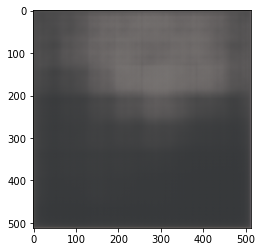

target


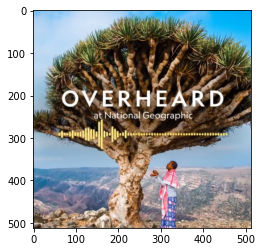

input_1


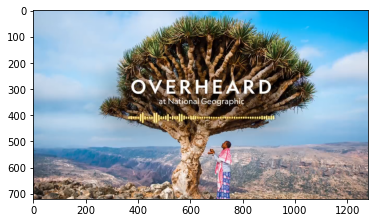

input_2


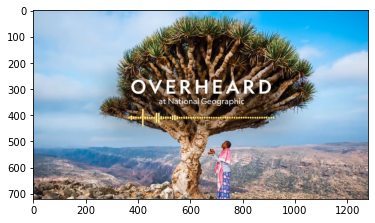

prediction


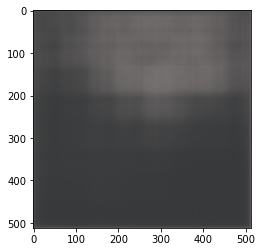

target


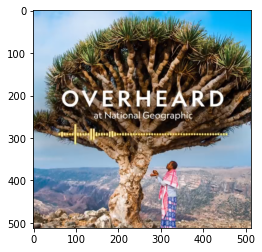

input_1


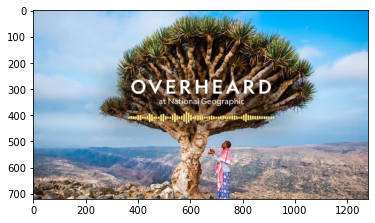

input_2


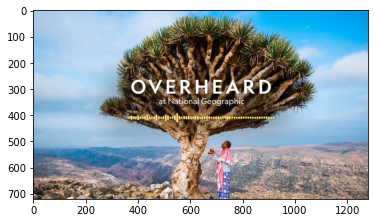

prediction


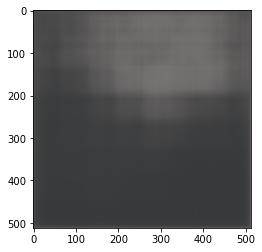

target


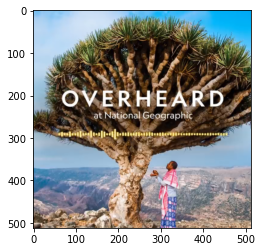

input_1


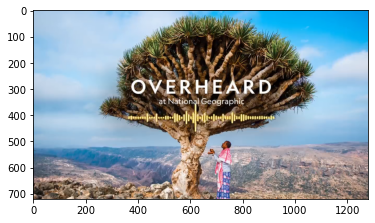

input_2


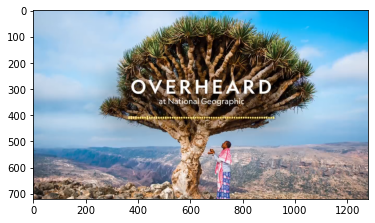

prediction


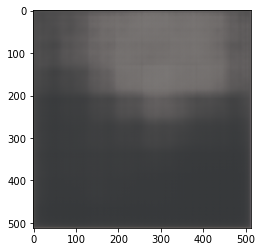

target


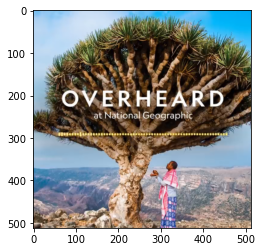

input_1


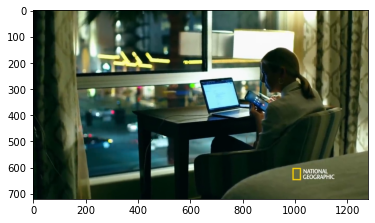

input_2


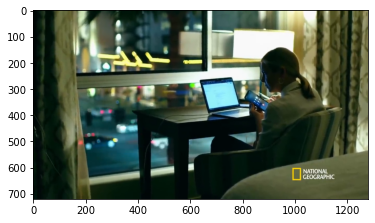

prediction


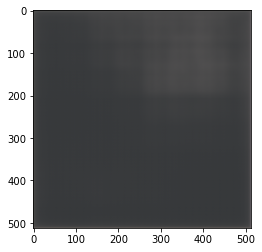

target


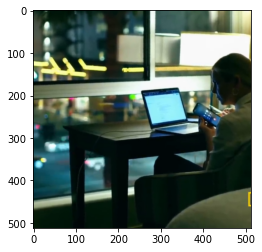

input_1


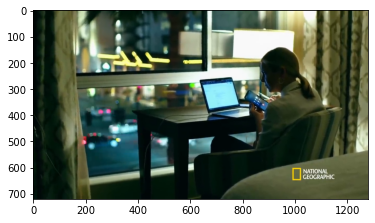

input_2


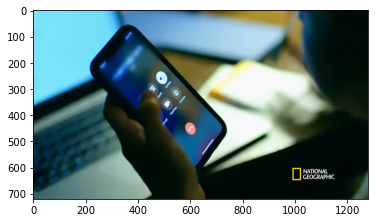

prediction


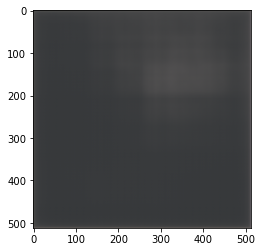

target


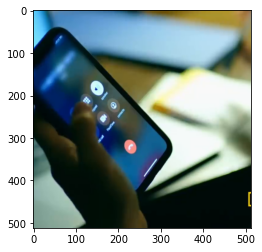

input_1


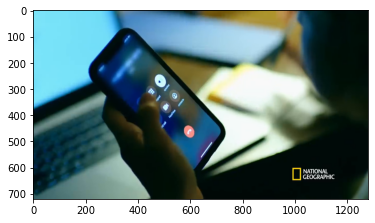

input_2


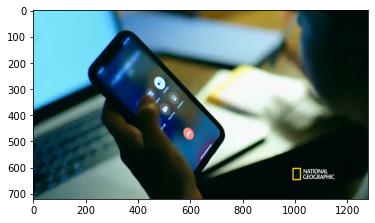

prediction


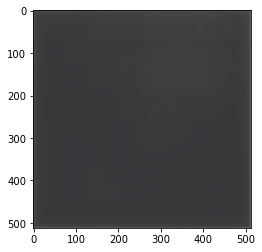

target


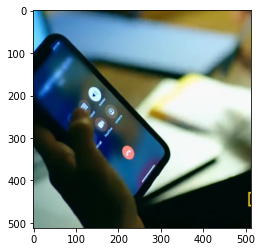

input_1


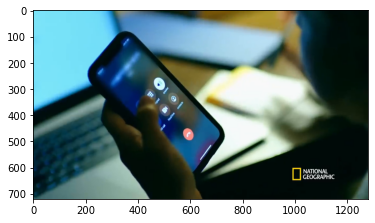

input_2


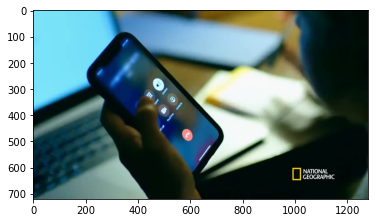

prediction


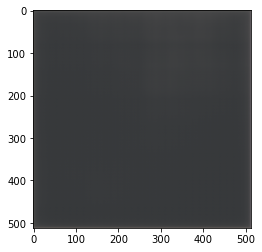

target


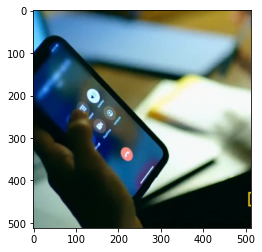

input_1


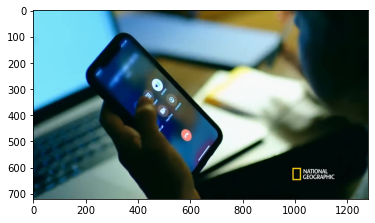

input_2


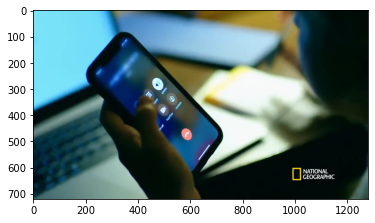

prediction


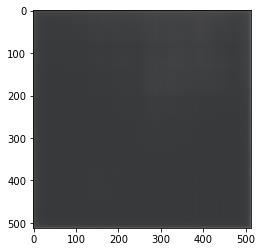

target


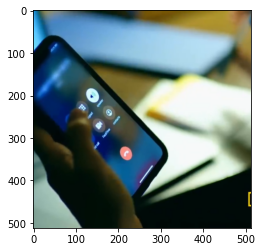

input_1


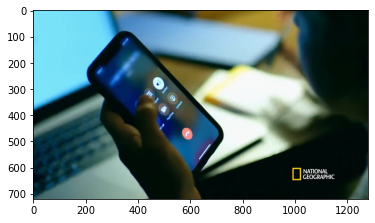

input_2


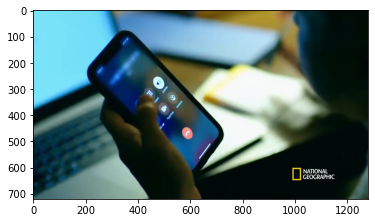

prediction


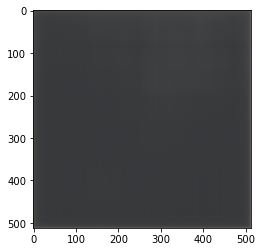

target


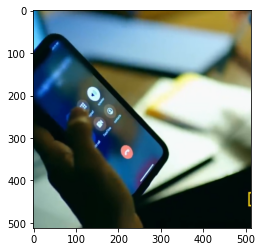

input_1


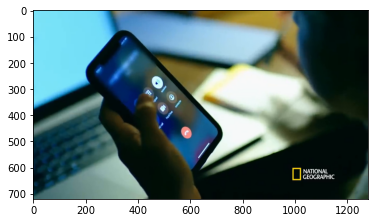

input_2


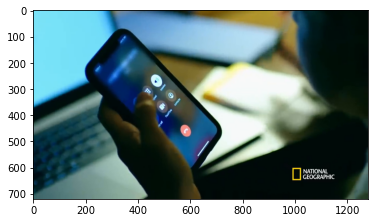

prediction


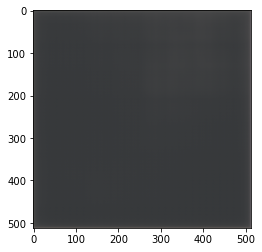

target


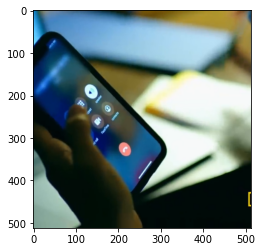

input_1


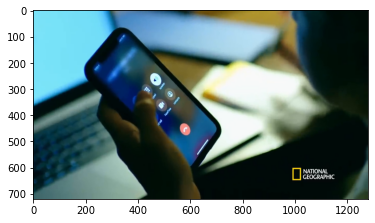

input_2


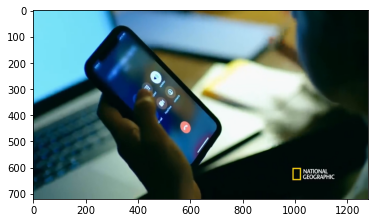

prediction


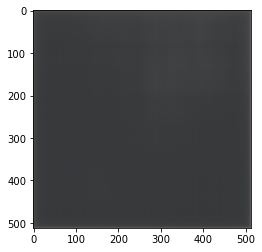

target


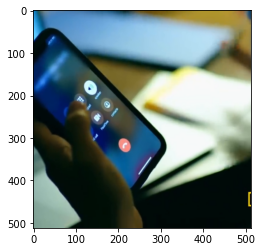

input_1


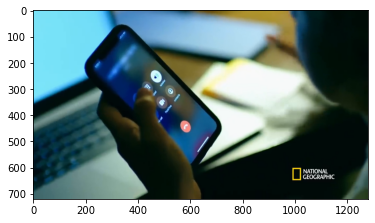

input_2


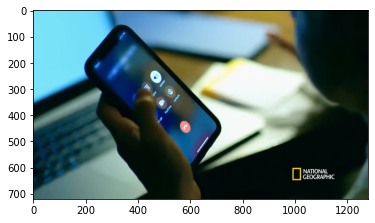

prediction


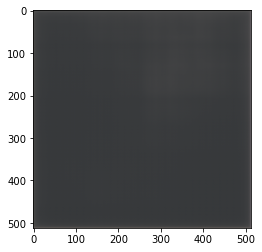

target


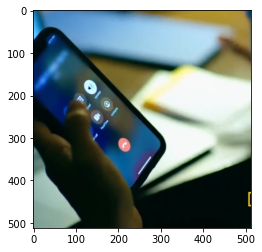

input_1


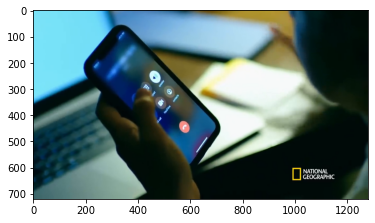

input_2


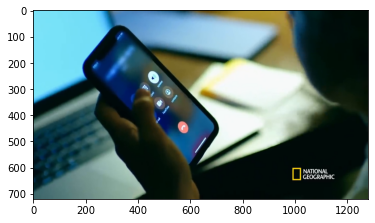

prediction


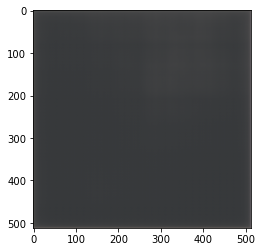

target


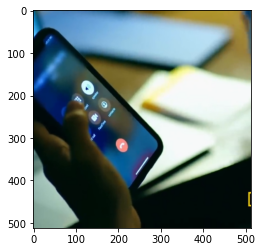

input_1


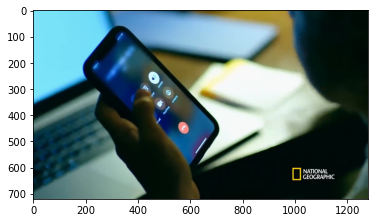

input_2


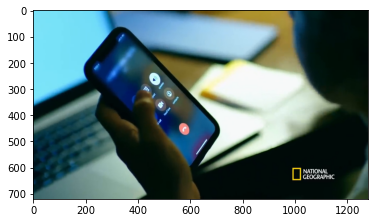

prediction


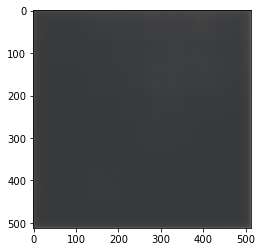

target


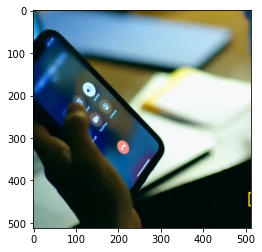

input_1


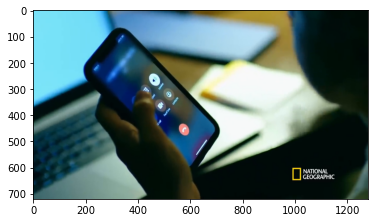

input_2


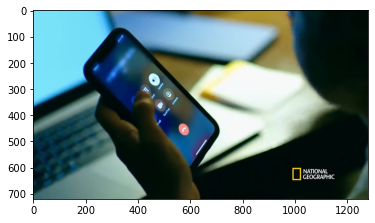

prediction


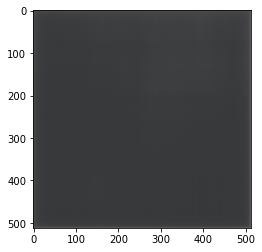

target


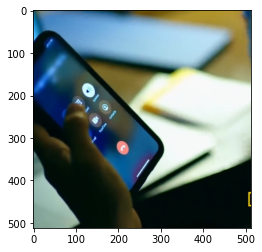

input_1


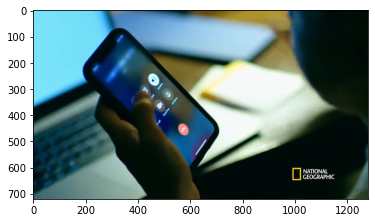

input_2


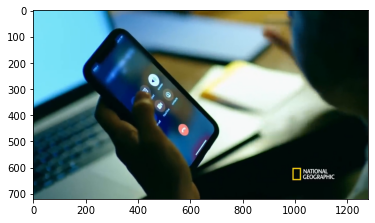

prediction


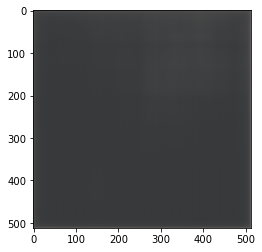

target


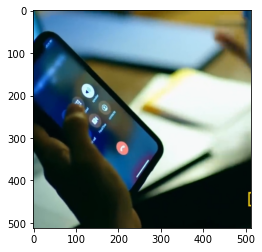

input_1


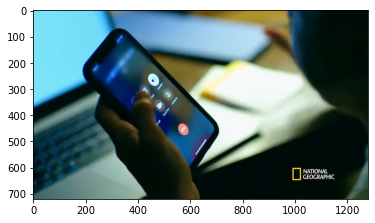

input_2


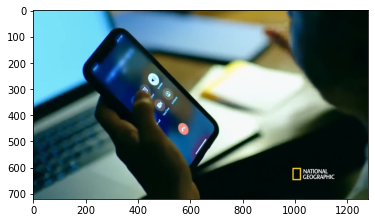

prediction


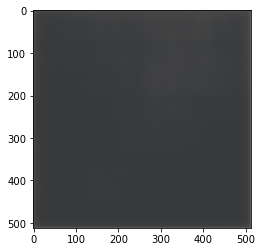

target


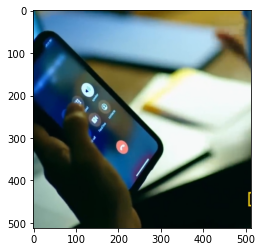

input_1


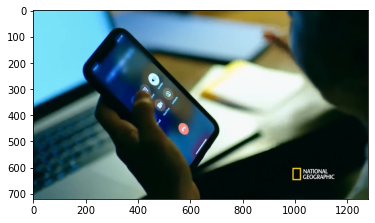

input_2


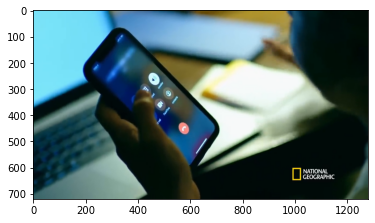

prediction


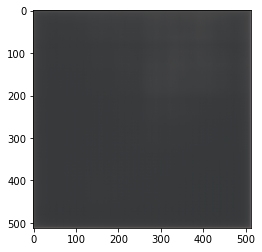

target


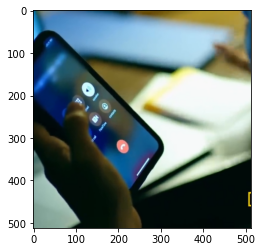

input_1


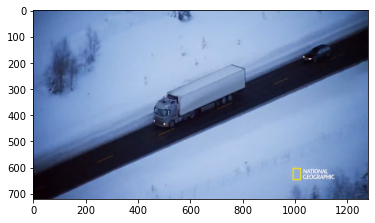

input_2


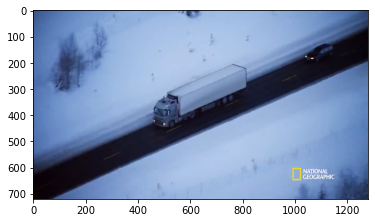

prediction


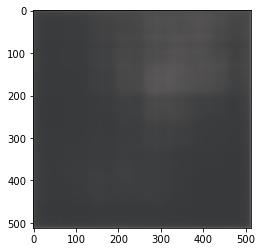

target


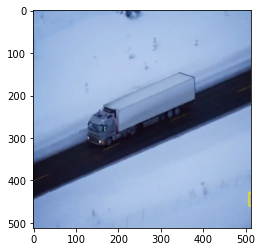

input_1


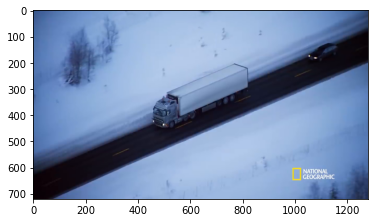

input_2


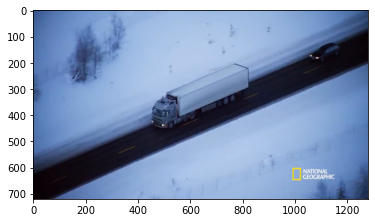

prediction


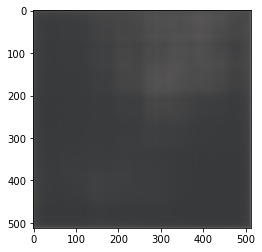

target


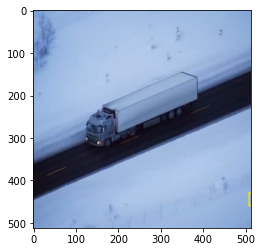

input_1


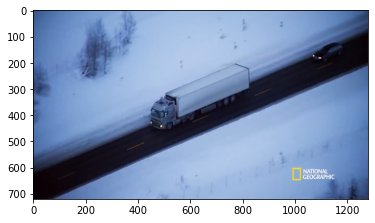

input_2


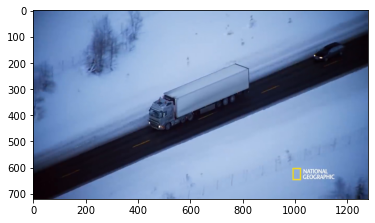

prediction


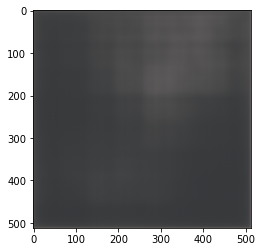

target


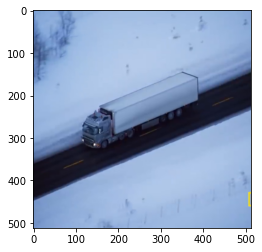

input_1


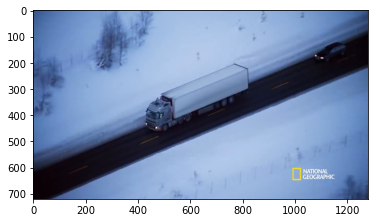

input_2


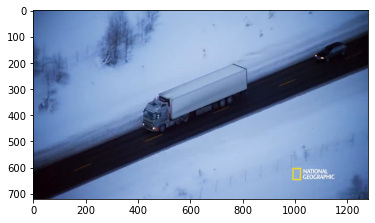

prediction


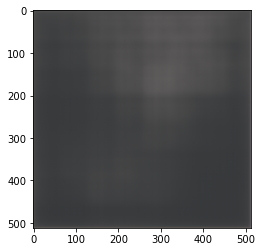

target


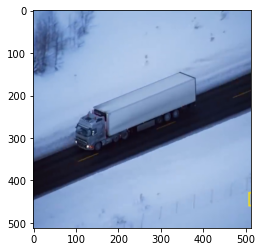

input_1


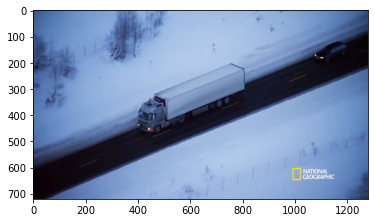

input_2


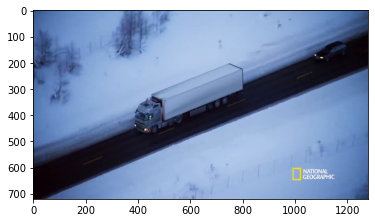

prediction


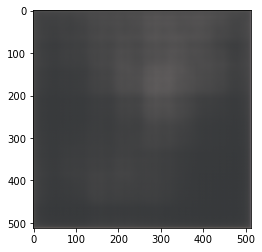

target


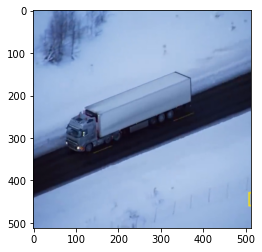

input_1


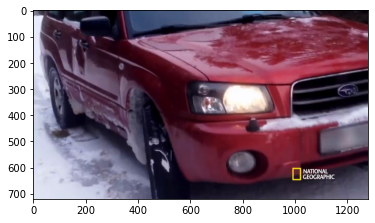

input_2


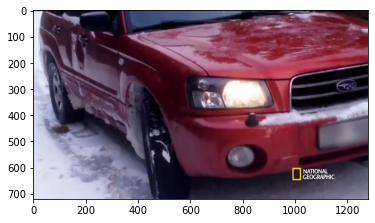

prediction


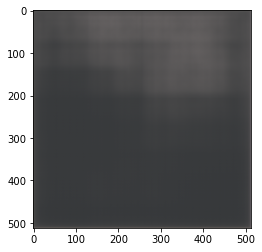

target


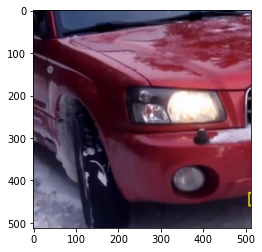

input_1


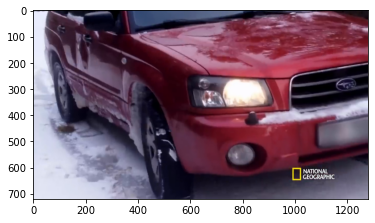

input_2


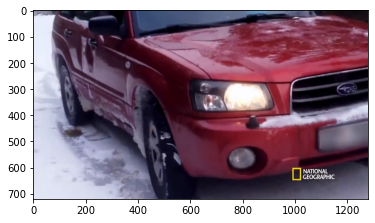

prediction


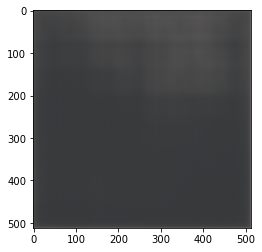

target


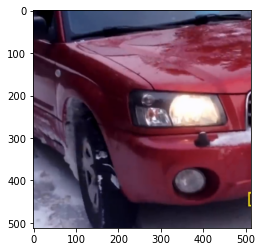

input_1


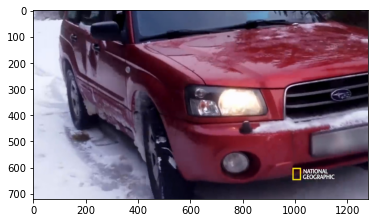

input_2


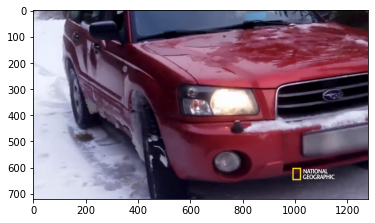

prediction


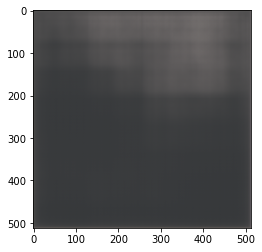

target


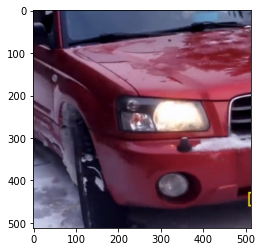

input_1


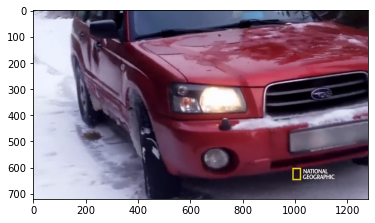

input_2


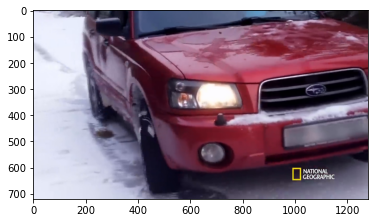

prediction


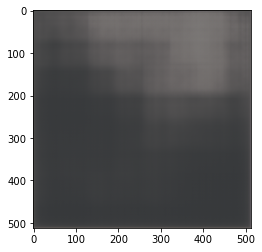

target


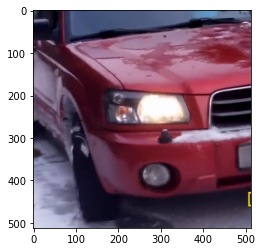

input_1


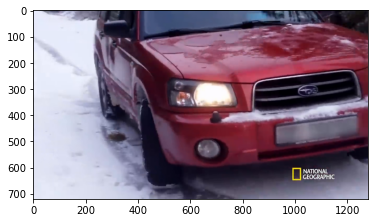

input_2


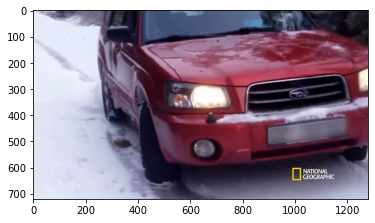

prediction


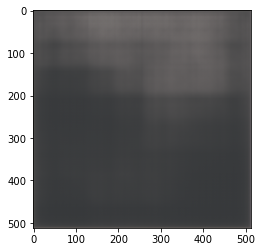

target


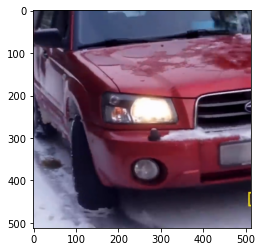

input_1


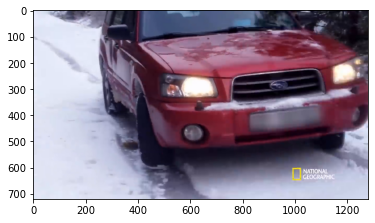

input_2


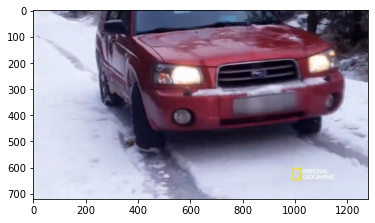

prediction


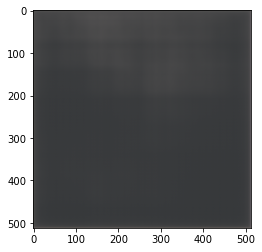

target


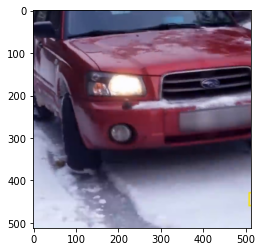

input_1


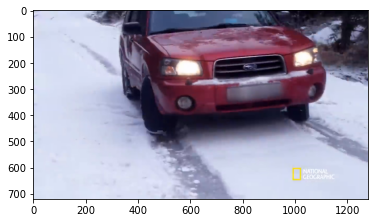

input_2


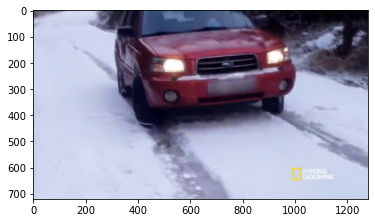

prediction


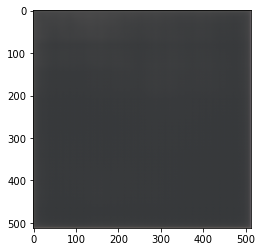

target


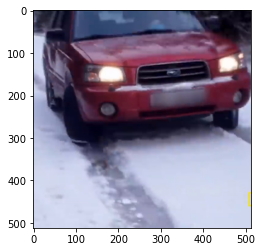

input_1


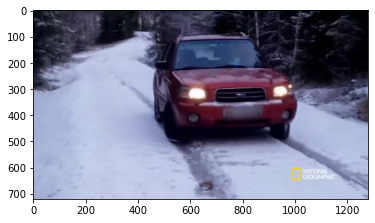

input_2


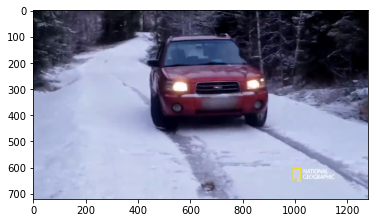

prediction


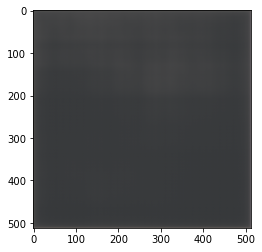

target


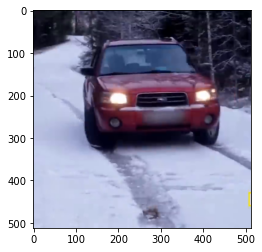

input_1


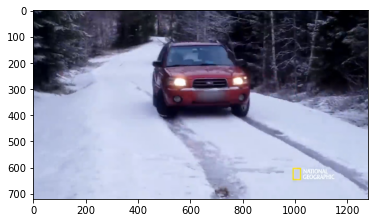

input_2


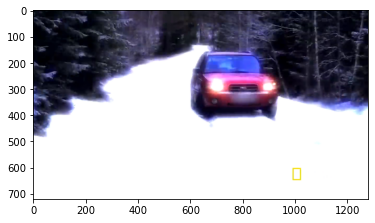

prediction


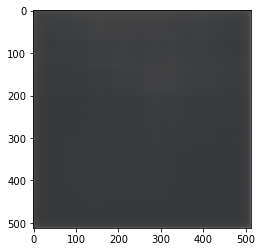

target


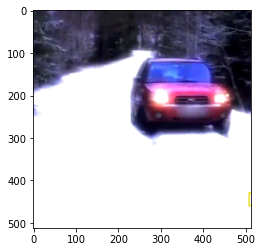

input_1


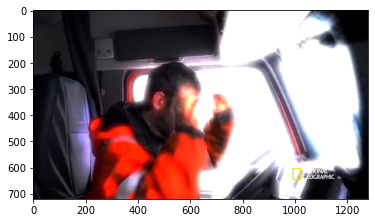

input_2


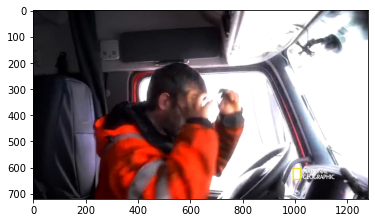

prediction


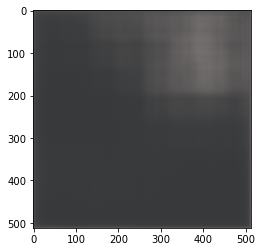

target


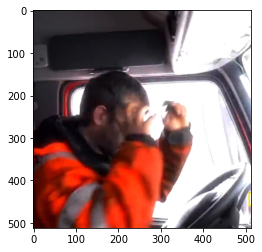

In [17]:
test_visualize(resnet_result, bottleneck_result, decoder_result)

In [13]:
prediction = last_prediction[1].cpu().detach()
target = batched_point[1][1]
input_target = data_transforms['train_in_no_normalize'](batched_point[1][1].permute(2,0,1))
print(prediction.shape)
#prediction_img = transforms.ToPILImage(prediction)
print(target.shape)

print("The original target frame")
plt.imshow(target)
plt.show()

transformed_target = data_transforms['train_target'](target.permute(2,0,1))
print("the target to optimize for")
plt.imshow(transformed_target.permute(1,2,0))
plt.show()
print("what the model saw")
plt.imshow(transforms.functional.to_pil_image(input_target))
plt.show()
print("what the model made")
plt.imshow(transforms.functional.to_pil_image(prediction))
plt.show()
print("bilinear baseline")
plt.imshow(transforms.functional.resize(transforms.functional.to_pil_image(input_target), 512))
#plt.plot(losses)

NameError: name 'last_prediction' is not defined